In [51]:
import numpy as np
import pandas as pd
from DbConn import *
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use("fivethirtyeight")
import seaborn as sns

In [52]:
db = DbConn()

In [62]:
sql = """
SELECT MAX_AUDIACC, SCRNCNT, SHOWCNT
FROM (SELECT MOVIECD, MAX(AUDIACC) AS MAX_AUDIACC FROM BOXOFFICE GROUP BY MOVIECD HAVING MAX(AUDIACC) > 130000) m
JOIN BOXOFFICE b ON m.MOVIECD = b.MOVIECD 
"""

In [63]:
datas = pd.read_sql(sql, db.connection)

In [64]:
datas.head(30)

,MAX_AUDIACC,SCRNCNT,SHOWCNT
0,14401147,1241,5724
1,7201087,964,4231
2,1699701,724,3110
3,512168,496,956
4,4445387,518,1225
5,1384205,366,833
6,504883,153,178
7,212657,128,258
8,815050,87,111
9,384279,98,105


(array([9929., 3394., 1725.,  953.,  508.,  423.,  257.,  338.,  146.,
         119.]),
 array([  131232. ,  1876469.6,  3621707.2,  5366944.8,  7112182.4,
         8857420. , 10602657.6, 12347895.2, 14093132.8, 15838370.4,
        17583608. ]),
 <a list of 10 Patch objects>)

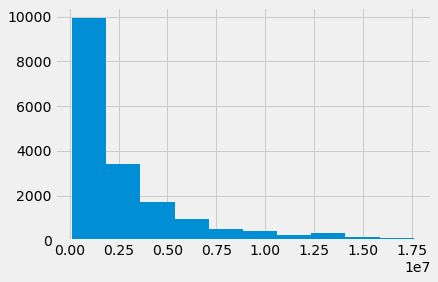

In [65]:
plt.hist(datas['MAX_AUDIACC'])


In [66]:
# 정규성 검정
from scipy.stats import shapiro
n1 = shapiro(datas['SCRNCNT'])
n2 = shapiro(datas['MAX_AUDIACC'])
n3 = shapiro(datas['SHOWCNT'])
n1, n2, n3
# SCRNCNT : ((0.8692032098770142, 6.678117883575149e-31), 
# MAX_AUDIACC : (0.5266233682632446, 0.0))
# SHOWCNT : (0.8112751245498657, 1.0888834334379095e-35))

C:\Users\user\anaconda3\envs\bigdata\lib\site-packages\scipy\stats\morestats.py:1309: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")
C:\Users\user\anaconda3\envs\bigdata\lib\site-packages\scipy\stats\morestats.py:1309: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")
C:\Users\user\anaconda3\envs\bigdata\lib\site-packages\scipy\stats\morestats.py:1309: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


((0.905535101890564, 0.0),
 (0.7489142417907715, 0.0),
 (0.8171334862709045, 0.0))

In [67]:
# 등분산 검정
from scipy.stats import bartlett
bartlett(datas['SCRNCNT'], datas['MAX_AUDIACC'])
# BartlettResult(statistic=19563.277339355453, pvalue=0.0)

BartlettResult(statistic=301171.02452123136, pvalue=0.0)

In [68]:
# ttest_rel
from scipy.stats import ttest_rel

ttest_rel(datas['SCRNCNT'], datas['MAX_AUDIACC'])

Ttest_relResult(statistic=-111.29539676635994, pvalue=0.0)

In [70]:
# hsd = pairwise_tukeyhsd(datas['SCRNCNT'], datas['MAX_AUDIACC'], alpha=0.05)
# # hsd.summary()

group1,group2,meandiff,lower,upper,reject
131232,131698,-78.6944,-638.7429,481.354,False
131232,131883,276.5833,-474.8005,1027.9672,False
131232,133342,118.4643,-596.2443,833.1729,False
131232,133373,556.75,-1007.3802,2120.8802,False
131232,133522,59.2045,-568.0861,686.4952,False
131232,133596,242.3056,-420.3527,904.9638,False
131232,134520,-70.5833,-684.0857,542.919,False
131232,134924,248.0357,-466.6729,962.7443,False
131232,135287,-53.6944,-716.3527,608.9638,False
131232,136090,162.8929,-551.8157,877.6015,False


In [ ]:
corr = datas

# 기 각 !

In [41]:
director_sql = """
SELECT DIRECTORS, AVG(MAX_AUDIACC) AS AVG_MAX_AUDIACC FROM MOVIEDETAIL m GROUP BY DIRECTORS ORDER BY AVG_MAX_AUDIACC DESC 
"""

In [42]:
director = pd.read_sql(director_sql, db.connection)
director.head()

,DIRECTORS,AVG_MAX_AUDIACC
0,김한민,17583608.0
1,윤제균,14241429.0
2,김용화,13332980.0
3,최동훈,12686446.0
4,장훈,12166659.0


(array([1.018e+03, 7.800e+01, 3.300e+01, 1.200e+01, 5.000e+00, 4.000e+00,
        3.000e+00, 2.000e+00, 1.000e+00, 1.000e+00]),
 array([7.14000000e+02, 1.75900340e+06, 3.51729280e+06, 5.27558220e+06,
        7.03387160e+06, 8.79216100e+06, 1.05504504e+07, 1.23087398e+07,
        1.40670292e+07, 1.58253186e+07, 1.75836080e+07]),
 <a list of 10 Patch objects>)

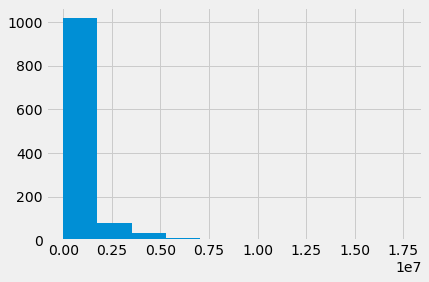

In [44]:
plt.hist(director['AVG_MAX_AUDIACC'])

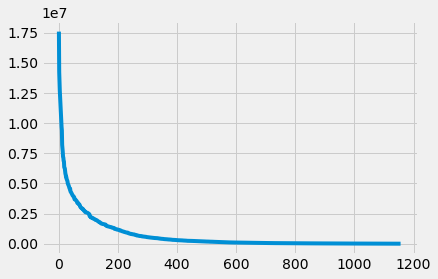

In [45]:
plt.plot(director['AVG_MAX_AUDIACC'])